Homework 3

Kelcey Davis

Colaborators: Bjorn, London

Time to complete: 6 hours (I spent a lot of time staring at problem 1.)

In [1]:
import astropy.units as u
import astropy.constants as c
from astropy.coordinates import SkyCoord
from astropy.time import Time
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import glob
%matplotlib inline

In [2]:
plt.rcParams['figure.figsize'] = (10, 10)
plt.rc('axes', labelsize=14)
plt.rc('axes', labelweight='bold')
plt.rc('axes', titlesize=16)
plt.rc('axes', titleweight='bold')
plt.rc('font', family='sans-serif')

# Problem 1

The radial velocity of a star orbiting the Galactic Center is given by:

$v_r = \Theta cos(\alpha) - \Theta_0 sin(l)$

where l is the Galactic longitude of the star, $\Theta_0$ is the orbital velocity of the local standard of rest
of the Sun system (LSR; the Sun if it had perfectly circular motion about the Galactic Center), $\Theta$
is the orbital velocity curve as a function of distance from the Galactic Center (R), and α is the
angle between the line connecting the tangent and the Galactic Center and the line connecting the
star and the Galactic Center (see diagram from notes below).

Knowing that the maximum velocity ($\Theta_{max}$ ) occurs at the tangent point, show that the orbital
velocity curve as a function of distance from the Galactic Center (R) can be expressed as:

$\Theta(R) = \Theta_{max} + \Theta_0 sin(l)$

You may replace Θ with V for velocity if you prefer at any point in this problem (up to you!), for
a nal expression

$V(R) = V_{max} + V_0 sin(l)$

**answer**

We can assume that at the tangent point, $\alpha = 0$. This changes our diagram and simplifies things a little. The new diagram looks like: 

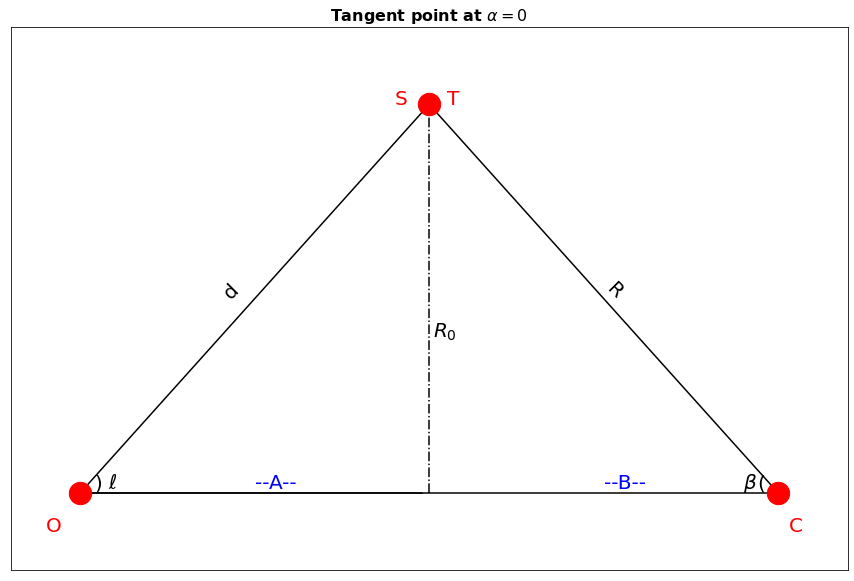

In [132]:
plt.rcParams['figure.figsize'] = (15, 10)

x = np.arange(0,2,.01)

plt.plot(x,np.repeat(0,len(x)), c = 'k')
plt.plot()

m = 1
b = 0

x = y = np.arange(0,.99,.01)
plt.plot(x, m*x+b, c = 'k')
plt.plot(np.repeat(1,len(y)), y, linestyle = '-.', c = 'k')
m = 1
b = 2

xs = np.arange(0.99, 2)
plt.plot(xs, -m*xs+b, c = 'k')

x2 = np.arange(0,2,.01)
plt.plot(x,np.repeat(0,len(x)), c = 'k')
plt.scatter([0,2,1],[0,0,1], s = 500, c = 'r', zorder = 10)

plt.text(-.1,-.1,'O', fontsize = 20, c = 'r')
plt.text(0.04,0.01,')', fontsize = 20)
plt.text(0.08, 0.01, r'$\ell$', fontsize = 20)
plt.text(0.4,0.5,'d', rotation = 45, fontsize = 20)
plt.text(1.5,.5,'R', rotation = -45, fontsize = 20)
plt.text(1.01,0.4,r'$R_0$', fontsize = 20)
plt.text(1.05,1, 'T', fontsize = 20, c = 'r')
plt.text(.9,1, 'S', fontsize = 20, c = 'r')
plt.text(2.03,-0.1,'C', fontsize = 20, c = 'r')
plt.text(1.94,0.01,'(', fontsize = 20)
plt.text(1.9,0.01, r'$\beta$', fontsize = 20)

plt.text(0.5,.01,'--A--', color = 'b', fontsize  = 20)
plt.text(1.5,.01,'--B--', color = 'b', fontsize  = 20)

plt.xlim(-.2,2.2)
plt.ylim(-.2, 1.2)
plt.xticks([])
plt.yticks([])

plt.title(r'Tangent point at $\alpha = 0$');

We now have a much simpler diagram! Back to the formula we started with:

$V(r) = V cos\alpha - V_0 sin\ell$

We know that $\alpha$ goes to 0 at this tangent point, so 

$cos \alpha = cos 0 = 1$

We also see from my diagram that:

$sin\ell = \frac{d}{R_0}$

And that leaves us to solve for d.

Collecting the things we know:

$sin\ell = \frac{R_0}{d}$

$sin\beta = \frac{R_0}{R}$

I'm defining A and B as the unknown triangle sides, indicated in my figure. I can tell we need some laws of cosines, so I'll include a figure to reference:


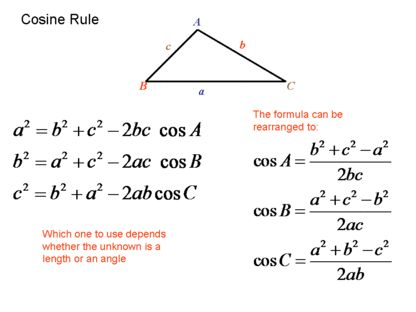


$cos\beta = \frac{B^2 + R^2 - R_0^2}{2BR}$

$cos\ell = \frac{A^2 + d^2 - R_0^2}{2Ad}$


I will alos define an arbitrary length Z to be the distance between points T and C in the homework diagram, which simply has too many lines for me to draw out in matplotlib.

---
I have done a lot of round-about math here to kind of come to the conclusion that I am not sure. I think this problem might be a bit simpler than I am making it, or maybe I was right there and didn't quite make it. I'll leave my previous work here in case this is something that warrants partial credit, but here is the simpler aproach I am going with:



I denoted a distance between points T and C to be Z in this arbitrary frame where $\alpha$ = 0. Replacing our $\Theta$ values with Vs:


$v_r = \Theta cos(\alpha) - \Theta_0 sin(l)$

$V(r) = V cos(\alpha) - V_0 sin(\ell)$

$V(Z) = V_{max} = V(r) cos(\alpha) - V_0 sin(\ell)$

we let $\alpha$ = 0

$V_{max} = V(r) cos(0) - V_0 sin(\ell)$

$V_{max} = V(r) - V_0 sin(\ell)$

$V(r) = V_{max} + V_0 sin(\ell)$

# Problem 2

a. One simple back-of-the-envelope estimate for the mass density of dark matter suggests that it
follows the following form,

$\rho(r) = \frac{V^2}{4 \pi G r^2}$

where ρ is the mass density, V is the orbital velocity, G is the gravitational constant, and r is
distance from the center of the Galaxy. Using this approximation, estimate the mass density
of dark matter in the solar neighborhood in units of g cm  ́3 , M d pc  ́3 , and M d AU ́3 . Also
look up the stellar mass density in the solar neighborhood, and compare these values.

For our solar neighborhood, we will use:

V: orbital velocity of the sun

r: distance from galactic center

In [151]:
V = 230*(u.km/u.s)
r = 26000*u.lyr

We get a density in grams per cubic centimeter of:

In [152]:
rho = (V**2)/(4*np.pi*c.G*(r**2))
r = rho.to(u.g/(u.cm**3))
print(f'{r:.2e}')

1.04e-24 g / cm3


We will use astropy to grab the solar mass:

In [153]:
msun = u.M_sun
msun

Unit("solMass")

We will aslo use it to get the mass in grams:

In [165]:
msung = msun.to(u.g)
msung

1.988409870698051e+33

and the conversion to parsecs:

In [166]:
con = (1*(u.cm**3)).to(u.pc**3)
con

<Quantity 3.40367719e-56 pc3>

and our conversion factor from dimenstional analysis is:

$\frac{g}{cm^3}\frac{Msol}{2x10^{33}g}\frac{3.4x10^{56}cm^3}{pc^3}$

$\frac{1g}{1cm^3} = \frac{3.4x10^{56}}{2x10^{33}}\frac{Msol}{pc^3}$

In [175]:
rsolpc = r.value*(1/(con.value*msung))
print(f'This is a density of {round(rsolpc,3)} [Msol/pc^3]')

This is a density of 0.015 [Msol/pc^3]


The conversion from cubic centimeters to cubic AU is:

In [178]:
con = (1*(u.cm**3)).to(u.AU**3)
con

<Quantity 2.98692119e-40 AU3>

and our conversion factor from dimenstional analysis is:

$\frac{g}{cm^3}\frac{Msol}{2x10^{33}g}\frac{3x10^{40}cm^3}{AU^3}$

$\frac{1g}{1cm^3} = \frac{3x10^{40}}{2x10^{33}}\frac{Msol}{AU^3}$

In [182]:
rsolpc = r.value*(1/(con.value*msung))
print(f'This is a density of {rsolpc:.2e} [Msol/AU^3]')

This is a density of 1.76e-18 [Msol/AU^3]


b. One modication to this simplistic expression for the dark matter mass density has been made
to force the density function to approach a constant value near the center, rather than diverge.
This formula appears to be consistent with reality and takes the form

$\rho(r) = \frac{\rho_0}{1+[\frac{r}{a}]^2}$

Show that the enclosed mass of dark matter at a radius r is given by:

$M_r = 4 \pi \rho_0 a^2 [r-atan^{-1}(\frac{r}{a})]$

(Feel free to use an integral table, numerical integrator, or ask me for help on this part!)
Assume that there is 5.4 ˆ1011 M d of dark matter in the inner 50 kpc of the Galaxy and
determine ρ 0 in unites of M d pc  ́3 . You can assume that a = 2.8 kpc

We will think of this as adding up a series of shells of enclosed mass of infinetesimal length dr.

Imagine something like this, where the shells move outward from the center and each are evenly spaced by our infinitesimal distance dr.

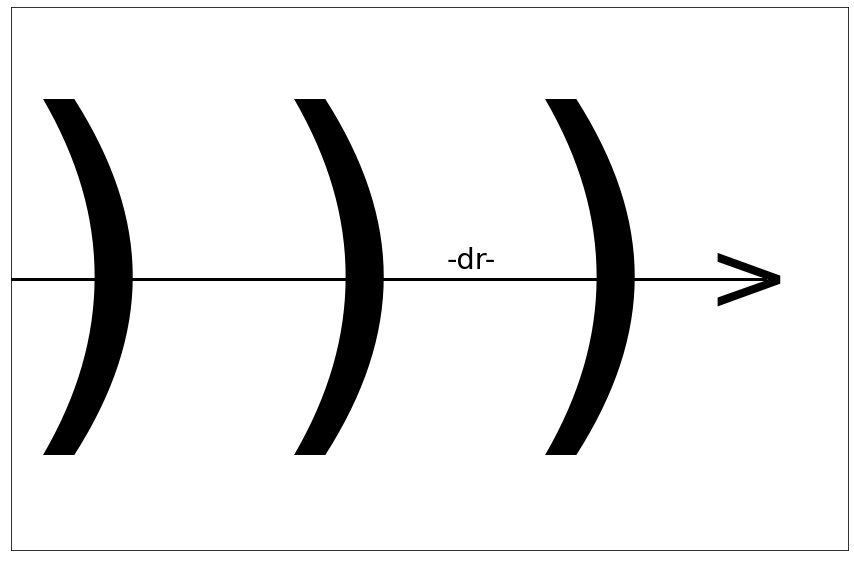

In [249]:
x = np.arange(0,1,0.1)
plt.plot(x, np.repeat(1,len(x)), c = 'k', lw = 3)
plt.text(0,.975,')', fontsize = 400)
plt.text(0.3,.975,')', fontsize = 400)
plt.text(0.6,.975,')', fontsize = 400)
plt.text(0.83,0.9936,'>', fontsize = 100)
plt.text(0.52,1.002,'-dr-', fontsize  = 29)

plt.ylim()
plt.xlim(0,0.999)
plt.xticks([])
plt.yticks([]);

We can consider the mass density at some distance to be:

$\rho = \frac{m_{encl}}{V}$

and

$m_{encl} = \rho V$

$m_{encl} = \int 4\pi r^2 \rho dr$

$m_{encl} = \int 4 \pi r^2[\frac{\rho_0}{1+[\frac{r}{a}]^2}] dr$

$m_{encl} = 4 \pi \rho_0  \int r^2[\frac{1}{1+[\frac{r}{a}]^2}] dr$

this looks like a job for wolfram alpha! I plug it in and I get:

$m_{encl} = 4 \pi \rho_0 a^2[r - a tan^{-1}(\frac{r}{a})]$

which is the expression we hoped to prove! solved :)

I realize we could have set this up as a spherical integral but by just treating it as a 1-d problem and considering the surface area of a bunch of concentric spheres, the itegral is a little simpler. It looks like both ways work?

# Problem 3

Using the expression discussed in class (and found in the Schneider
textbook Ch. 2), you will calculate the expression npR, zq for the number density of stars at a
particular radial distance R from the Galactic center, and height z from the Galactic midplane.
Note that n(0,0) is the number density of stars, in units of stars pc  ́3 , in the disk at the Galactic
center (and is thus quasi-unrealistic, as directly at the center there is a supermassive black hole, but
we’ll ignore that for this problem).

a. (2 pts) Calculate the normalization n 0 , such that the number density in the Solar neighborhood
is 0.2 stars pc  ́3 . Note that the Sun is at z=30 pc.

from the book, chapter 2 page 47:

$n(R,z) = n_0[e^{-|z|/h_{thin}} + 0.02e^{-|z|/h_{thick}}]e^{-R/h_R}$ (2.34)

where:

R,z are cylindrical coordinates

$h_{thin} \approx .325 kpc$ (scale heigth of thin disk)

$h_r \approx 3.5 kpc$

$h_{thick} \approx 1.5 kpc$ (scale height of thick disk)



$n(R,z) = n_0[e^{-|z|/0.325 kpc} + 0.02e^{-|z|/1.5kpc}]e^{-R/3.5kpc}$ 

In [262]:
#Distance above the galactic place in kpc
z = 30*u.pc.to(u.kpc)
#Distance from the galactic center in kpc
R = 8
exp = (np.e**(-abs(z)/0.325) + 0.02*(np.e**(-abs(z)/1.5)))*np.e**(-R/3.5)
print(f'The portion of the equation to the left of n0 is {round(exp,3)}.')

The portion of the equation to the left of n0 is 0.095.


Our equation simplifies to:

$n(R,z) = n_0 0.095$

if we assume n(R,z) $\approx 0.2 \frac{stars}{pc^3} = 2000 \frac{stars}{kpc^3}$

$2000 = n_0 0.0095$

In [268]:
n0 = 2000/exp
print(f'n0 = {n0:.1e}')

n0 = 2.1e+04


b. (2 pts) At the Galactocentric radius of the Sun (R 0 „ 8.0 kpc), what is the stellar density (in
stars per pc 3 ) at z = r0, 10, 100, 1000s pc? (You will need to use your normalized expression.)

In [295]:
#Distance from the galactic center in kpc
R = 8
#Getting the exponential
exp = (np.e**(-abs(z)/0.325) + 0.02*(np.e**(-abs(z)/1.5)))*np.e**(-R/3.5)

for z in [0,10,100,1000]:
    exp = (np.e**(-abs(z)/0.325) + 0.02*(np.e**(-abs(z)/1.5)))*np.e**(-R/3.5)
    n = n0*exp
    print(f'The value for n(R,z) = {n:.1e} at z = {z}.')

The value for n(R,z) = 2.2e+03 at z = 0.
The value for n(R,z) = 5.5e-02 at z = 10.
The value for n(R,z) = 4.8e-28 at z = 100.
The value for n(R,z) = 1.3e-288 at z = 1000.


c. Let’s dene the “edge” of the Galactic disk radially as the point where the stellar
density reaches 0.1% (10  ́3 ) of the central value. Find the radial “edge” at the Galactic
midplane (z “ 0); i.e. nd R where n(R,0) = 10  ́3 n(0,0)

$n(R,z) = n_0[e^{-|z|/0.325 kpc} + 0.02e^{-|z|/1.5kpc}]e^{-R/3.5kpc}$ 

$\frac{n(R,z)}{n_0[e^{-|z|/0.325 kpc} + 0.02e^{-|z|/1.5kpc}]} =  e^{-R/3.5kpc}$

$ln [\frac{n(R,z)}{n_0[e^{-|z|/0.325 kpc} + 0.02e^{-|z|/1.5kpc}]}] = -R/3.5kpc$

$R = -3.5 ln [\frac{n(R,z)}{n_0[e^{-|z|/0.325 kpc} + 0.02e^{-|z|/1.5kpc}]}]$

In [316]:
z = 0
R = 0
exp = (np.e**(-abs(z)/0.325) + 0.02*(np.e**(-abs(z)/1.5)))*np.e**(-R/3.5)
nc = n0*exp
print(f'The value for n(0,0) at the galactic center is: {nc:.1e}.')

The value for n(0,0) at the galactic center is: 2.2e+04.


In [317]:
#Get the n value we are looking for:
n = nc*(0.1/100)
R = -3.5*np.log(n/(n0*(np.e**(-abs(z)/0.325) + 0.02*(np.e**(-abs(z)/1.5)))))
print(f'The R value is {round(R,1)} [kpc].')

The R value is 24.2 [kpc].


d. (2 pts) Do the same as question 3c but for the “edge” of the disk in height; i.e. nd z where
n(0,z) = 10  ́3 n(0,0).

$n(R,z) = n_0[e^{-|z|/0.325 kpc} + 0.02e^{-|z|/1.5kpc}]e^{-R/3.5kpc}$ 

$\frac{n(R,z)}{n_0 e^{-R/3.5kpc}} = [e^{-|z|/0.325 kpc} + 0.02e^{-|z|/1.5kpc}]$

Oh boy. That is some complicated algebra. I will look at the contribution from the thick and thin disks independently.

This gives us two equations:

(1) $\frac{n(R,z)}{n_0 e^{-R/3.5kpc}} = [e^{-|z|/0.325 kpc}]$

and

(2) $\frac{n(R,z)}{n_0 e^{-R/3.5kpc}} = [ 0.02e^{-|z|/1.5kpc}]$

They reduce to:

(1) $\frac{n(R,z)}{n_0 e^{-R/3.5kpc}} = [e^{-|z|/0.325 kpc}]$

$ln(\frac{n(R,z)}{n_0 e^{-R/3.5kpc}}) = -|z|/0.325 kpc$

$|z| = -.325  ln(\frac{n(R,z)}{n_0 e^{-R/3.5kpc}})$

and

(2) $\frac{n(R,z)}{n_0 e^{-R/3.5kpc}} = [ 0.02e^{-|z|/1.5kpc}]$

$|z| = -1.5  ln(\frac{n(R,z)}{0.02 n_0 e^{-R/3.5kpc}})$

I'll compute values for them both.

In [324]:
R = 0

z1 = -.325*np.log(n/(n0*np.e**(-R/3.5)))

In [327]:
z2 = -1.5*np.log(n/(0.02*n0*np.e**(-R/3.5)))
print(f'The possible values of z are betwen {round(z1,1)} and {round(z2,1)}.')

The possible values of z are betwen 2.2 and 4.5.


e. (5 pts) Show that the total number of stars in the Galactic disk is „1011 . This will involve
integrating the expression derived above in cylindrical coordinates. (You can do this analyt-
ically by parts. Feel free to use an integral table for specic parts, but compute the analytic
expression.) First, give the analytic expression, then you can plug in your limits of integration;
for the radial limit, use your result from part c; for the z-direction, use the result from part d.
As a reminder:(see integral)

This part got a bit intense to type so I will add some written portions of how I got to my end formula:

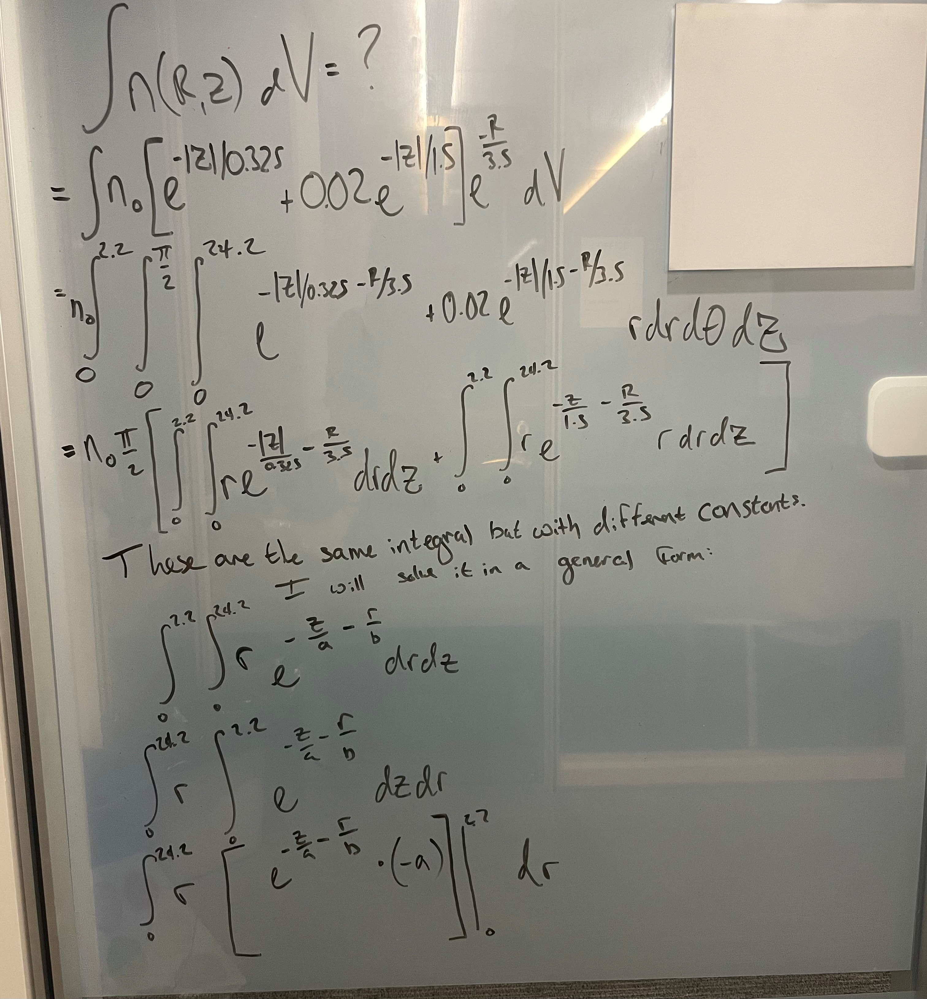

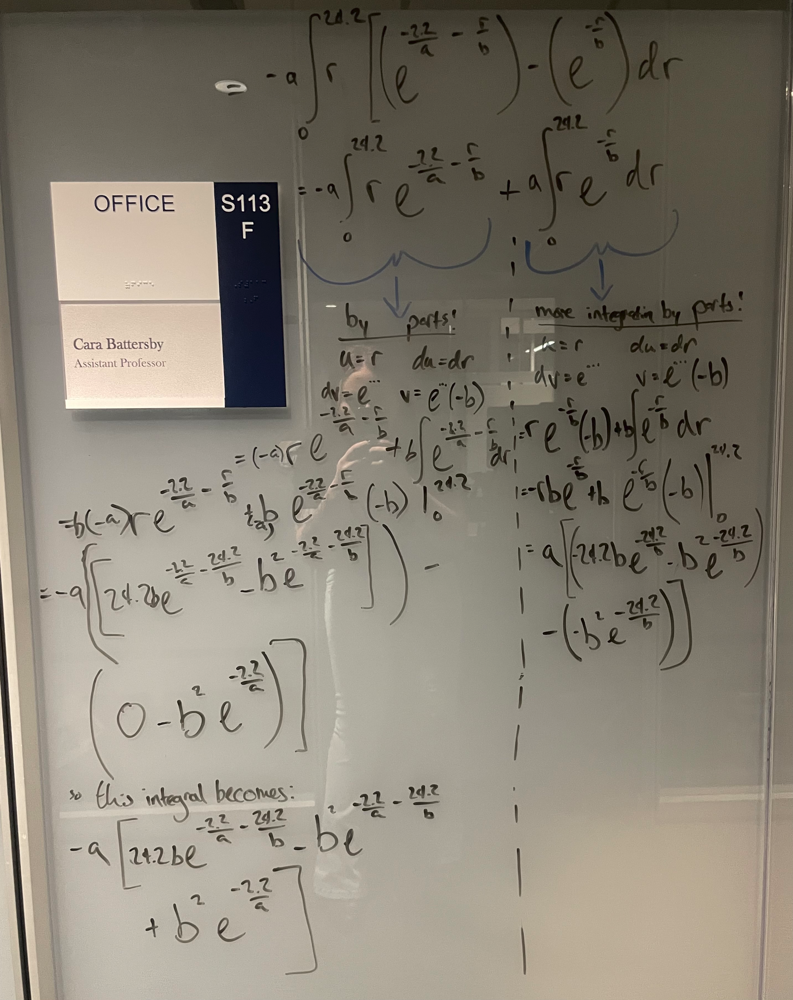

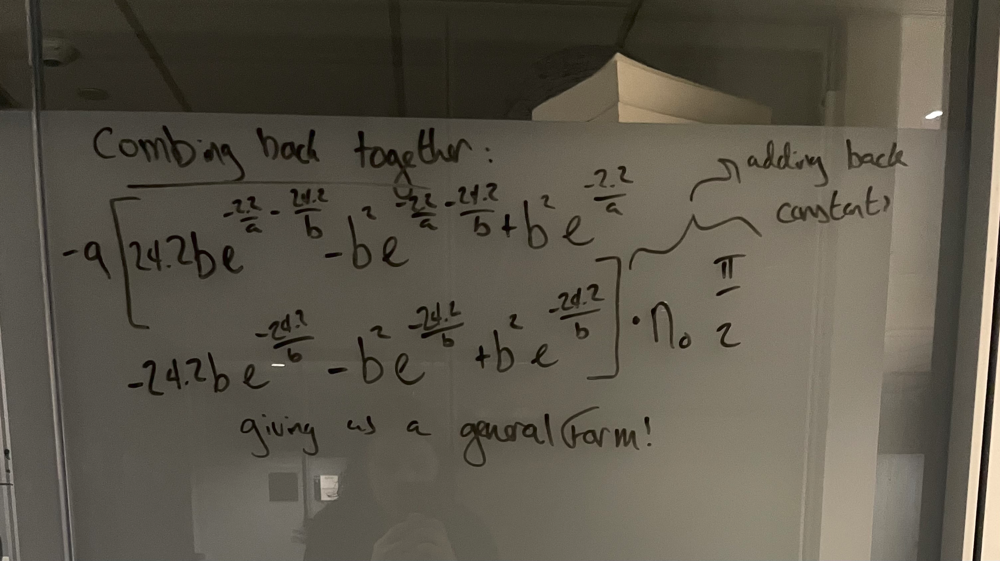

The integral solution I ended up with had the form:

$-a[24.2 b e^{\frac{-2.2}{a} - \frac{24.2}{b}} - b^2 e^{\frac{-2.2}{a} - \frac{24.2}{b}} + b^2 e^{\frac{-2.2}{a}} -24.2 b e^{\frac{-24.2}{b}} - b^2 e^{\frac{-24.2}{b}}+b^2 e^{\frac{-24.2}{b}}]$

it was actually a little early to add back in those constants at the end, but I was looking for a general form so that I could add them back together at the end. First, I will plug in values for the integral on the left:

In [332]:
a = 0.325
b = 3.5

e1 = np.e**((-2.2/a) - (-24.2/b))
e2 = np.e**(-2.2/a)
e3 = np.e**(-24.2/b)

int1 = -a*(24.2*b*e1 - (b**2)*e1 + (b**2)*e2 -24.2*b*e3 - (b**2)*e3 +(b**2)*e3)
print(f'The first integral chunk evaluates to {int1}.')

The first integral chunk evaluates to -27.19911685505932.


In [334]:
a = 1.5
b = 3.5

e1 = np.e**((-2.2/a) - (-24.2/b))
e2 = np.e**(-2.2/a)
e3 = np.e**(-24.2/b)

int2 = -a*(24.2*b*e1 - (b**2)*e1 + (b**2)*e2 -24.2*b*e3 - (b**2)*e3 +(b**2)*e3)
print(f'The second integral chunk evaluates to {int2}.')

The second integral chunk evaluates to -25238.95190975775.


We need to combine these numbers and add back in the constants:

In [339]:
intf = n0*np.pi*0.5*(abs(int1+int2))
print(f'We find that the density is {intf:.2e} stars.')

We find that the density is 8.38e+08 stars.


f.  Assuming that the typical mass of a star in the Milky Way is 0.5 M d , calculate the
total stellar mass of the disk

We have a total mass of:

In [344]:
mgal = intf*0.5*(u.M_sun)
print(f'This is a total of {mgal.value:.2e} solar masses.')

This is a total of 4.19e+08 solar masses.
